- [Прекод](#toc1_)    
- [Сборный проект-4](#toc2_)    
    - [Описание данных](#toc2_1_1_)    
  - [Исследовательский анализ данных](#toc2_2_)    
  - [Генерируем оценку](#toc2_3_)    
  - [Проверка данных](#toc2_4_)    
  - [Подготовим эмбединги](#toc2_5_)    
    - [Векторизация текстов](#toc2_5_1_)    
    - [Векторизация изображений](#toc2_5_2_)    
  - [Объединение векторов](#toc2_6_)    
  - [Генерируем оценку](#toc2_7_)    
  - [Соединяем датасет с эмбедингами](#toc2_8_)    
  - [Натренируем модель](#toc2_9_)    
    - [Используем catbost](#toc2_9_1_)    
    - [Используем нейронную сеть](#toc2_9_2_)    
  - [Тестируем модель](#toc2_10_)    
  - [Ранжирование с catboost](#toc2_11_)    
  - [Вывод](#toc2_12_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Прекод](#toc0_)

# <a id='toc2_'></a>[Сборный проект-4](#toc0_)

Вам поручено разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — покажет, насколько текст и картинка подходят друг другу.

### <a id='toc2_1_1_'></a>[Описание данных](#toc0_)

Данные находятся [здесь](https://st.yandex-team.ru/DS-6856).

В файле `train_dataset.csv` собрана информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.

3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

В файле `test_queries.csv` находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `test_images` содержатся изображения для тестирования модели.

In [ ]:
import os
import random
import numpy as np
from typing import Union
import copy

import torch
import torch.nn as nn
import spacy
import pandas as pd
import torchvision
import matplotlib.pyplot as plt
import torch
from PIL import Image
from pandas import Series, DataFrame
from tqdm.auto import tqdm
from transformers import AutoTokenizer, AutoModel
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import MultiStepLR
from albumentations.augmentations.transforms import Normalize
from albumentations.augmentations.geometric.resize import Resize
from sklearn.model_selection import GroupShuffleSplit
from catboost import CatBoostRegressor, CatBoostRanker, Pool
from sklearn.metrics import mean_squared_error
from pytorch_optimizer import AdaBelief

tqdm.pandas()
SEED = 1234
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

#!python -m spacy download en_core_web_sm

device = "cuda" if torch.cuda.is_available() else "cpu"

## <a id='toc2_2_'></a>[Исследовательский анализ данных](#toc0_)

In [ ]:
path_train_ds = os.path.join("data", "train_dataset.csv")
path_crowd_data = os.path.join("data", "CrowdAnnotations.tsv")
path_expert_data = os.path.join("data", "ExpertAnnotations.tsv")
path_train_image = os.path.join("data", "train_images")
path_test_img = os.path.join("data", "test_images")
path_test_img_df = os.path.join("data", "test_images.csv")
path_test_query = os.path.join("data", "test_queries.csv")

In [ ]:
train_ds = pd.read_csv(path_train_ds)
crowd_data = pd.read_csv(
    path_crowd_data,
    sep="\t",
    names=["image", "query_id", "ratio", "pos_count", "neg_count"],
)
expert_data = pd.read_csv(
    path_expert_data,
    sep="\t",
    names=["image", "query_id", "exp_1", "exp_2", "exp_3"],
)

In [ ]:
for name, shape in zip(
    ["train_ds", "crowd_data", "expert_data"], [train_ds, crowd_data, expert_data]
):
    print(name + ":", shape.shape)

train_ds: (5822, 3)
crowd_data: (47830, 5)
expert_data: (5822, 5)


In [ ]:
train_ds.head()

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [ ]:
crowd_data.head()

,image,query_id,ratio,pos_count,neg_count
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


In [ ]:
expert_data.head()

,image,query_id,exp_1,exp_2,exp_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


In [ ]:
len(train_ds['image'].unique()), len(train_ds['query_text'].unique())

(1000, 977)

В датасете имеется 1000 уникальных изображений и 977 уникальных текстовых описаний. 

## <a id='toc2_3_'></a>[Генерируем оценку](#toc0_)

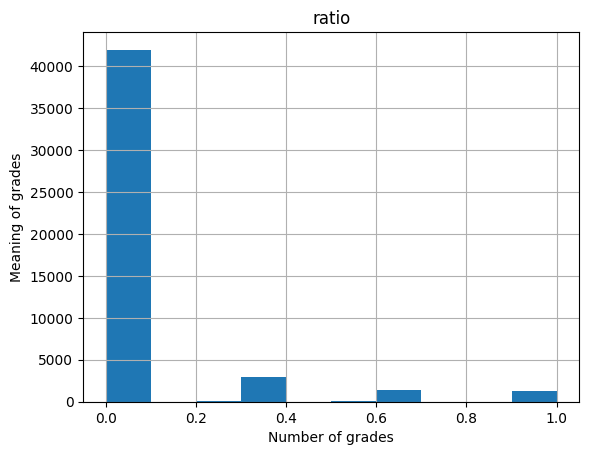

In [ ]:
ration_crowd = crowd_data[["image", "query_id", "ratio"]]
axarr = pd.DataFrame.hist(ration_crowd, "ratio", sharex=True, sharey=True)
for ax in axarr.flatten():
    ax.set_xlabel("Number of grades")
    ax.set_ylabel("Meaning of grades")

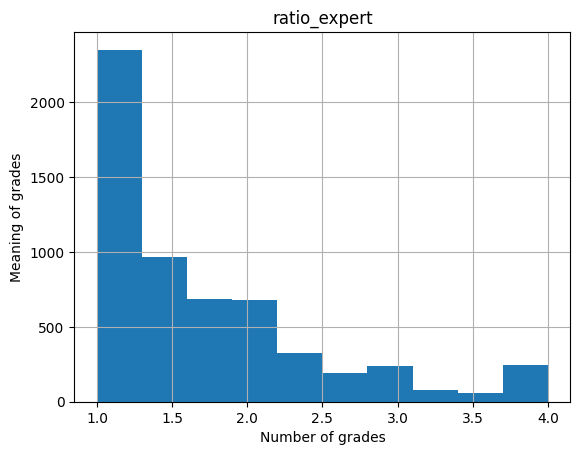

In [ ]:
expert_new = expert_data[["image", "query_id"]].copy()
expert_new["ratio_expert"] = (
    expert_data["exp_1"] + expert_data["exp_2"] + expert_data["exp_3"]
) / 3
axarr = pd.DataFrame.hist(expert_new, "ratio_expert", sharex=True, sharey=True)
for ax in axarr.flatten():
    ax.set_xlabel("Number of grades")
    ax.set_ylabel("Meaning of grades")

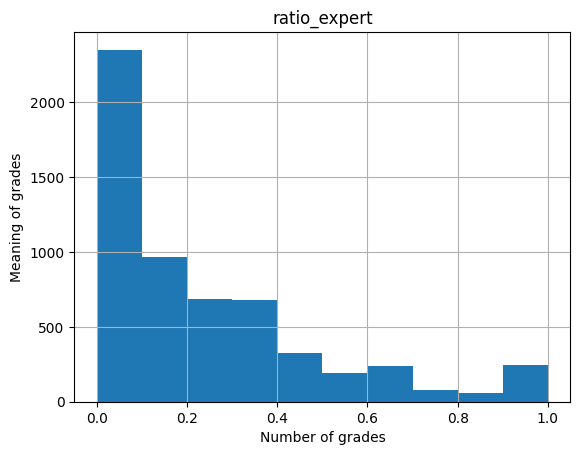

In [ ]:
max_exp = expert_new["ratio_expert"].max()
min_exp = expert_new["ratio_expert"].min()
expert_new["ratio_expert"] = (expert_new["ratio_expert"] - min_exp) / (
    max_exp - min_exp
)
axarr = pd.DataFrame.hist(expert_new, "ratio_expert", sharex=True, sharey=True)
for ax in axarr.flatten():
    ax.set_xlabel("Number of grades")
    ax.set_ylabel("Meaning of grades")

Теперь оценка экспертов приведена к шкале от 0 до 1.

In [ ]:
def big_merge(df_list: list[DataFrame], on=["image", "query_id"]):
    new_df = df_list[0]
    for num in range(len(df_list)):
        if num == len(df_list) - 1:
            return new_df
        new_df = pd.merge(new_df, df_list[num + 1], on=on)
        print(new_df.shape)

In [ ]:
train_ds.shape

(5822, 3)

In [ ]:
df_full = big_merge([train_ds, ration_crowd, expert_new])
df_full.sample(1)

(2329, 4)
(2329, 5)


,image,query_id,query_text,ratio,ratio_expert
1893,2534502836_7a75305655.jpg,447111935_5af98563e3.jpg#2,Two dogs wearing shirts play in the green grass .,0.0,0.444444


In [ ]:
df_crowd = big_merge([train_ds, ration_crowd])
df_crowd.sample(1)

(2329, 4)


,image,query_id,query_text,ratio
1201,2160266952_a2ab39191b.jpg,2073964624_52da3a0fc4.jpg#2,"A woman wearing black clothes , a purple scarf...",0.0


In [ ]:
df_expert = big_merge([train_ds, expert_new])
df_expert.sample(1)

(5822, 4)


,image,query_id,query_text,ratio_expert
3664,2518508760_68d8df7365.jpg,2968182121_b3b491df85.jpg#2,Two greyhounds race .,0.666667


Как видно из представленных данных наибольшее число совпадений по колонкам image, query_id у исходных данных и у данных экспертов, к тому же оценка экспертов распределена ровнее.

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
По вышеизложенным причинам, возьмем тот тренировочный датасет, который состоит из исходных данных и оценок экспертов. 
</div>

In [ ]:
df_expert.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   image         5822 non-null   object 
 1   query_id      5822 non-null   object 
 2   query_text    5822 non-null   object 
 3   ratio_expert  5822 non-null   float64
dtypes: float64(1), object(3)
memory usage: 182.1+ KB


In [ ]:
df_expert.head()

,image,query_id,query_text,ratio_expert
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.222222
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.000000
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000


<div class="alert" style="background-color:#ead7f7;color:#8737bf">
Добавил явный вывод о том какой датасет я сформировал и вывел о нем информацию через head и info
</div>

## <a id='toc2_4_'></a>[Проверка данных](#toc0_)

Для эффиктивного поиска слов, указывающих на наличие несовершеннолетнего на изображении лемматизируем текст

In [ ]:
# создадим метод, который будет проводить лемматизацию и поиск определнных слов
class FilterData:
    def __init__(
        self,
        df: DataFrame,
        child_words: list = [
            "child",
            "boy",
            "girl",
            "baby",
            "children",
            "kid",
            "teenager",
        ],
    ):
        self.df = df
        self.child_words = child_words
        self.sp = spacy.load("en_core_web_sm")

        self.exclude = set()
        self.image_with_text = set()

    def __filter_data(self, x: Series):
        sent = x["query_text"]
        query_id = x["query_id"].split("#")[0]
        self.image_with_text.add(query_id)

        sent = self.sp(sent)
        for word in sent:
            if word.lemma_ in self.child_words:
                self.exclude.add(query_id)
                break

    def run(self):
        self.df.progress_apply(self.__filter_data, axis=1)

        return list(self.exclude)

In [ ]:
filter_data = FilterData(df_expert)
result = filter_data.run()

  0%|          | 0/5822 [00:00<?, ?it/s]

In [ ]:
len(result)

285

In [ ]:
train_ds.shape

(5822, 3)

In [ ]:
sum(~train_ds["image"].isin(result))

4118

In [ ]:
train_ds_child = df_expert.loc[df_expert["image"].isin(result)]
train_ds_not_child = df_expert.loc[~df_expert["image"].isin(result)]

In [ ]:
train_ds_child.shape, train_ds_not_child.shape

((1704, 4), (4118, 4))

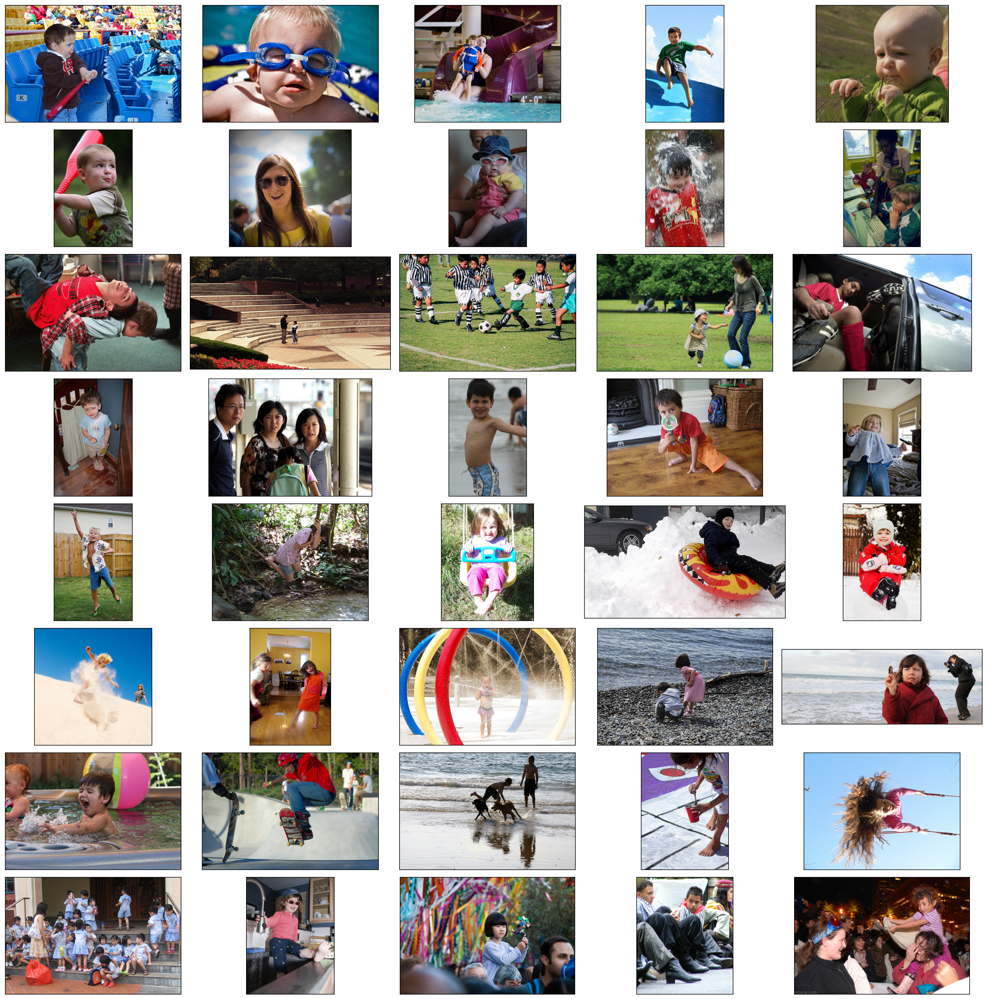

In [ ]:
# изобразим детские изображения
fig = plt.figure(figsize=(20, 20))
for num, image_name in enumerate(train_ds_child["image"].unique()[:40]):
    img = Image.open(os.path.join(path_train_image, image_name))
    fig.add_subplot(8, 5, num + 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

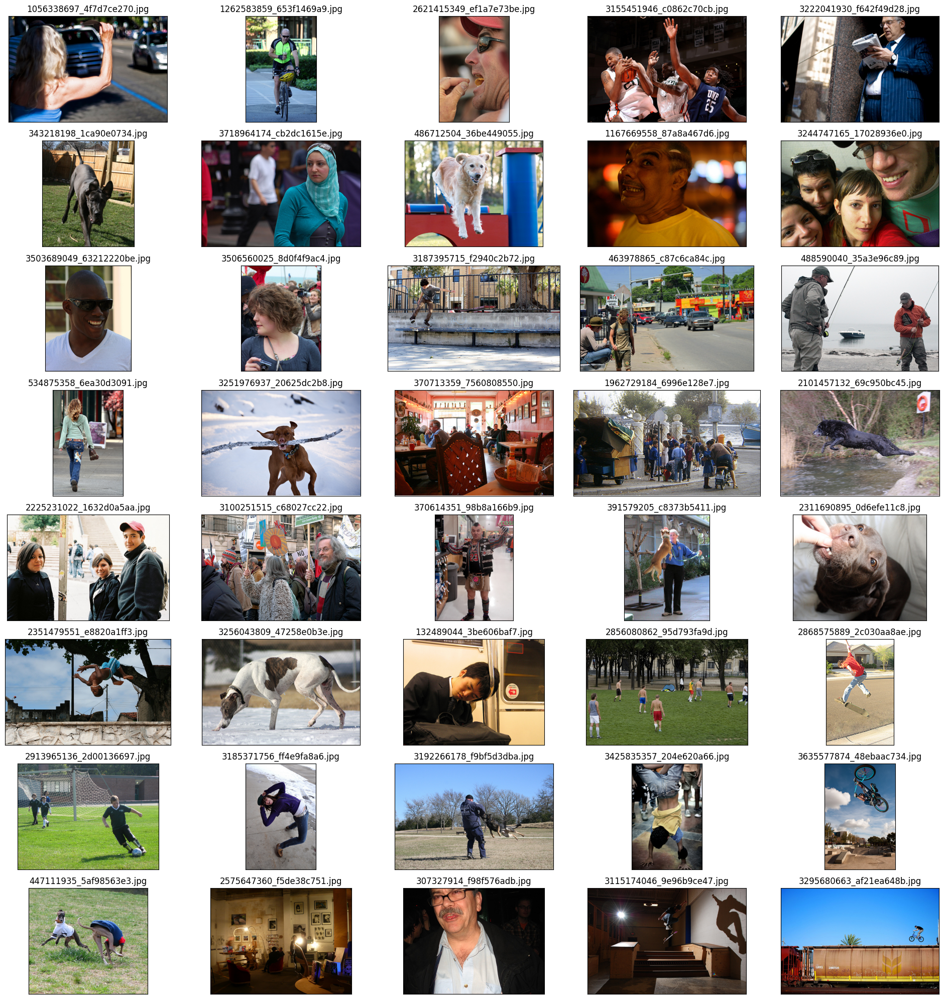

In [ ]:
# проверим "взрослые"
fig = plt.figure(figsize=(20, 20))
for num, image_name in enumerate(train_ds_not_child["image"].unique()[:40]):
    img = Image.open(os.path.join(path_train_image, image_name))
    fig.add_subplot(8, 5, num + 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.title(image_name)
    plt.tight_layout()

В ходе осмотра оставшихся фотографий, найдены фотографии, на которых изображены дети (приведены ниже в списке). 

In [ ]:
child_without_text = [
    "2913965136_2d00136697.jpg",
    "3079787482_0757e9d167.jpg",
    "2533642917_a5eace85e6.jpg",
    "1343426964_cde3fb54e8.jpg",
    "416788726_5b4eb1466e.jpg",
]

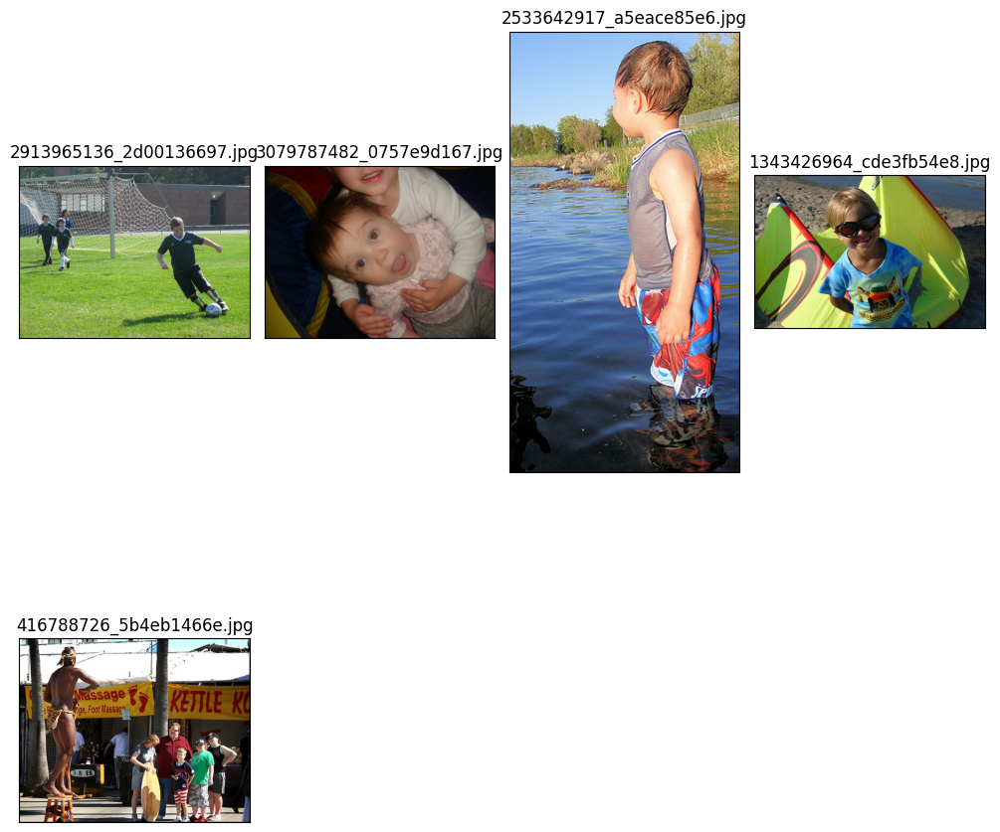

In [ ]:
fig = plt.figure(figsize=(10, 10))
for num, image_name in enumerate(child_without_text):
    img = Image.open(os.path.join(path_train_image, image_name))
    fig.add_subplot(2, 4, num + 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.title(image_name)
    plt.tight_layout()

Удалим их

In [ ]:
train_ds_not_child.shape, sum(~(train_ds_not_child["image"].isin(child_without_text)))

((4118, 4), 4085)

In [ ]:
train_ds_not_child = train_ds_not_child.loc[
    ~(train_ds_not_child["image"].isin(child_without_text))
]

In [ ]:
train_ds_not_child.shape

(4085, 4)

## <a id='toc2_5_'></a>[Подготовим эмбединги](#toc0_)

### <a id='toc2_5_1_'></a>[Векторизация текстов](#toc0_)

Чтобы индексы исходного датасета, совпадали с индексами, эмбедингов, которые мы получим, присвоим индексы в датасете заново и преобразуем его в отдельную колонку.

In [ ]:
train_ds_not_child.reset_index(drop=True, inplace=True)
train_ds_not_child.reset_index(inplace=True)

In [ ]:
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
model_bert = AutoModel.from_pretrained("bert-base-uncased").to(device)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
train_ds_not_child.sample(2)

,index,image,query_id,query_text,ratio_expert
1036,1036,3238951136_2a99f1a1a8.jpg,1554713437_61b64527dd.jpg#2,A grey dog walks on top of a fallen tree in th...,0.111111
3088,3088,2663794355_e726ec7e05.jpg,3619416477_9d18580a14.jpg#2,A white dog jumps in the water to catch a tenn...,0.000000


In [ ]:
class BuildDataset(Dataset):
    def __init__(self, df: DataFrame, tokenizer: object):
        super().__init__()
        self.df = df
        self.tokenizer = tokenizer

        self.list_text_size = []
        self.max_len = 512

    def set_len_text(self):
        self.list_text_size = self.df["query_text"].apply(
            lambda x: len(self.tokenizer.encode(x, add_special_tokens=True))
        )

        if max(self.list_text_size) < self.max_len:
            self.max_len = max(self.list_text_size)

    def __len__(self):
        return len(self.df)

    def __getitem__(self, index):
        token = self.tokenizer(
            self.df.loc[index, "query_text"],
            max_length=self.max_len,
            padding="max_length",
            truncation=True,
            return_tensors="pt",
            add_special_tokens=True,
        )

        return {
            "input_ids": token["input_ids"],
            "attention_mask": token["attention_mask"],
            "index": index,
        }

<Axes: >

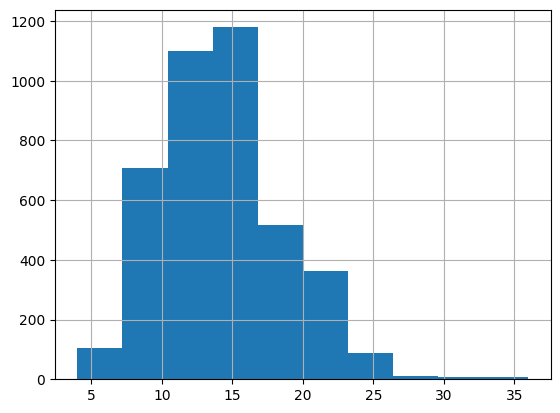

In [ ]:
data_albert = BuildDataset(train_ds_not_child, tokenizer)
data_albert.set_len_text()
data_albert.list_text_size.hist()

In [ ]:
data_albert.list_text_size.mean(), data_albert.list_text_size.median()

(14.215422276621787, 14.0)

Описания в основном небольшие.

In [ ]:
batch_size = 100

train_load = DataLoader(data_albert, batch_size=batch_size, num_workers=0)
embeddings = {"emb": []}
num = 0
for batch in train_load:
    num += 1
    print(f"{num}/{len(train_load)}", end="\r")
    with torch.no_grad():
        token = torch.squeeze(batch["input_ids"], dim=1).to(device)
        mask = torch.squeeze(batch["attention_mask"], dim=1).to(device)

        batch_embeddings = model_bert(token, attention_mask=mask)

    embeddings["emb"].append(batch_embeddings[0][:, 0, :].cpu().numpy())

In [ ]:
embed = embeddings["emb"]
embed_np = np.concatenate(embed)
df_emb_text = pd.DataFrame(embed_np)
df_emb_text.reset_index(inplace=True)

In [ ]:
print(df_emb_text.shape)
df_emb_text.sample(1)

(4085, 769)


,index,0,1,2,3,4,5,6,7,8,...,758,759,760,761,762,763,764,765,766,767
406,406,-0.06436,0.253158,-0.639127,0.260738,-0.333401,-0.556995,0.037885,0.467999,0.017449,...,-0.509297,0.439953,0.16171,0.235986,-0.186729,0.314477,0.063483,-0.409398,0.233835,0.574435


### <a id='toc2_5_2_'></a>[Векторизация изображений](#toc0_)

Создадим класс на основе Dataset, для предобработки изображений будем использовать Resize(256, 256) и Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), параметры взяты из документации (https://pytorch.org/vision/main/models/generated/torchvision.models.resnet50.html)

In [ ]:
class BuildDatasetImage(Dataset):
    def __init__(
        self,
        df: DataFrame,
        path: str,
        normalize: Union[bool, Normalize] = Normalize(
            mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
        ),
        resize: Union[bool, Resize] = Resize(256, 256),
    ):
        super().__init__()
        self.df = df
        self.path = path
        self.normalize = normalize
        self.resize = resize

    def __len__(self):
        return len(self.df)

    def __getitem__(self, index):
        image = self.df.loc[index, "image"]
        img_x = Image.open(f"{self.path}/{image}")
        img_x = np.array(img_x, dtype="float32")

        if self.resize:
            img_x = self.resize(image=img_x)["image"]

        if self.normalize:
            img_x = self.normalize(image=img_x)["image"]
        img_x = torch.from_numpy(img_x).permute(2, 0, 1)
        return {"img_x": img_x, "index": index}

In [ ]:
model_resnet = torchvision.models.resnet18().to(device)

In [ ]:
model_resnet.fc = nn.Identity()  # убираем слой классификации
model_resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
batch_size = 200
data_image = BuildDatasetImage(train_ds_not_child, path=path_train_image)
data_image = DataLoader(data_image, batch_size=batch_size)
embeddings = {"emb": []}
num = 0
for batch in data_image:
    num += 1
    print(f"{num}/{len(data_image)}", end="\r")
    with torch.no_grad():
        img_x = batch["img_x"].to(device)
        batch_embeddings = model_resnet(img_x)

    embeddings["emb"].append(batch_embeddings.cpu().numpy())

In [ ]:
embed = embeddings["emb"]
embed_np = np.concatenate(embed)
df_emb_img = pd.DataFrame(embed_np)
df_emb_img.reset_index(inplace=True)

In [ ]:
print(df_emb_img.shape)
df_emb_img.sample(1)

(4085, 513)


,index,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
1511,1511,1.62673,0.011048,1.694202,2.665339,0.077617,4.308662,3.127806,0.117773,2.390604,...,4.717957,0.12321,6.240633,0.236087,0.072542,0.332226,0.304811,2.692302,1.620801,1.535811


## <a id='toc2_6_'></a>[Объединение векторов](#toc0_)

In [ ]:
df_emb_text.sample(1)

,index,0,1,2,3,4,5,6,7,8,...,758,759,760,761,762,763,764,765,766,767
2541,2541,-0.157751,0.58394,-0.233784,-0.08398,0.080444,-0.483916,0.30572,0.786109,-0.237591,...,-0.285742,0.016653,0.051002,0.018585,-0.187348,1.05879,0.230253,-0.070941,0.211597,0.374764


In [ ]:
df_emb_img.sample(1)

,index,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
1093,1093,0.685775,0.0,1.409755,1.841777,0.063979,2.958833,2.196203,0.009706,1.969657,...,3.364109,0.099611,4.255259,0.15246,0.078573,0.453883,0.139995,1.747637,0.773071,1.174746


In [ ]:
df_emb = pd.merge(df_emb_text, df_emb_img, on="index", suffixes=("_text", "_img"))

In [ ]:
df_emb.sample(1)

,index,0_text,1_text,2_text,3_text,4_text,5_text,6_text,7_text,8_text,...,502_img,503_img,504_img,505_img,506_img,507_img,508_img,509_img,510_img,511_img
2511,2511,-0.678496,-0.236018,-0.569627,-0.019498,-0.177257,-0.056863,0.045215,1.014018,-0.431644,...,3.758791,0.123134,4.786515,0.195788,0.11549,0.356372,0.320634,2.141596,0.955942,1.419025


Эмбединг текста размерностью 768, эмбединг изображения размерностью 512. Вместе, полученный эмбединг каждого объекта составляет 1280

## <a id='toc2_7_'></a>[Генерируем оценку](#toc0_)

Распределение сохраненно, но теперь величена расспределена от 0 до 1.

Как видно из представленных данных наибольшее число совпадений по колонкам image, query_id у исходных данных и у данных экспертов, к тому же оценка экспертов распределена ровнее, поэтому возьмем ее в качестве таргета

## <a id='toc2_8_'></a>[Соединяем датасет с эмбедингами](#toc0_)

In [ ]:
train_ds_not_child.sample(5)

,index,image,query_id,query_text,ratio_expert
184,184,3150742439_b8a352e1e0.jpg,3365783912_e12c3510d8.jpg#2,Two men walk through a city with words on the ...,0.333333
1720,1720,3514179514_cbc3371b92.jpg,132489044_3be606baf7.jpg#2,"An asian man in a suit on the subway , asleep .",0.000000
3187,3187,754852108_72f80d421f.jpg,2666205903_8d287669e1.jpg#2,A girls in a blue shirt holds a flower while s...,0.222222
3026,3026,3655074079_7df3812bc5.jpg,3162045919_c2decbb69b.jpg#2,A man in a wetsuit surfs .,0.000000
543,543,2933637854_984614e18b.jpg,3218480482_66af7587c8.jpg#2,A Miami basketball player dribbles by an Arizo...,0.111111


In [ ]:
df_result = pd.merge(train_ds_not_child, df_emb, on="index")

In [ ]:
df_result.sample(5)

,index,image,query_id,query_text,ratio_expert,0_text,1_text,2_text,3_text,4_text,...,502_img,503_img,504_img,505_img,506_img,507_img,508_img,509_img,510_img,511_img
928,928,132489044_3be606baf7.jpg,3191135894_2b4bdabb6d.jpg#2,A smaller art festival on the edge of a forest,0.000000,-0.170534,-0.494831,-0.083217,0.395582,0.237061,...,4.836354,0.145433,6.803277,0.185093,0.073236,0.272068,0.272904,3.055136,1.521926,1.649555
533,533,261490838_2f3ac98b12.jpg,3028969146_26929ae0e8.jpg#2,A golden retriever running on short grass wear...,0.333333,-0.603948,-0.541273,-0.932280,0.334297,0.153660,...,3.616429,0.082346,4.838693,0.135773,0.043271,0.167221,0.182744,2.104874,1.367983,1.331827
1192,1192,3640422448_a0f42e4559.jpg,3320356356_1497e53f80.jpg#2,A man scales a rock in the forest .,0.333333,0.076595,0.135257,-0.746537,-0.138331,0.061475,...,5.455316,0.111465,6.999074,0.330141,0.065853,0.204878,0.483533,3.211600,1.707825,1.839502
3529,3529,421730441_6b2267fd31.jpg,3393343330_b13df4d8ec.jpg#2,A man is sitting at a table full of military i...,0.111111,0.010772,0.667544,-0.477608,-0.073070,0.128770,...,4.410574,0.166679,6.420314,0.183046,0.117261,0.226561,0.500073,2.798712,1.539847,1.300315
2474,2474,3554634863_5f6f616639.jpg,370713359_7560808550.jpg#2,"Crowded Mexican restaurant , empty chair in fo...",0.222222,-0.716690,-0.011991,-0.548261,0.027732,-0.130539,...,6.613444,0.192351,8.827139,0.240718,0.100390,0.305854,0.485623,3.755233,2.011932,2.074911


Так как метрика качестве представлена в виде числа с плавающей точкой, попробуем обучить модель регрессии, возьмем метрку RMSE.

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
Возбмем метрику RMSE, потому что она менее чувствительна к большим, но еденичным ошибкам
</div>

## <a id='toc2_9_'></a>[Натренируем модель](#toc0_)

### <a id='toc2_9_1_'></a>[Используем catbost](#toc0_)

In [ ]:
drop_x = ["index", "image", "query_id", "query_text", "ratio_expert"]
drop_y = []

gss = GroupShuffleSplit(n_splits=1, train_size=0.8)
train_indices, test_indices = next(
    gss.split(
        X=df_result.drop(
            columns=["index", "image", "query_id", "query_text", "ratio_expert"]
        ),
        y=df_result["ratio_expert"],
        groups=df_result["image"],
    )
)
train_df, test_df = df_result.loc[train_indices], df_result.loc[test_indices]

In [ ]:
train_df.shape, test_df.shape

((3277, 1285), (808, 1285))

In [ ]:
train_df.sample(1)

,index,image,query_id,query_text,ratio_expert,0_text,1_text,2_text,3_text,4_text,...,502_img,503_img,504_img,505_img,506_img,507_img,508_img,509_img,510_img,511_img
1430,1430,3503623999_bbd5dcfb18.jpg,114051287_dd85625a04.jpg#2,A boy in glasses is wearing a red shirt .,0.333333,0.144384,0.423151,-0.368448,-0.177508,-0.089701,...,5.515718,0.207988,7.671386,0.184093,0.135058,0.468322,0.409088,3.203191,1.70325,1.5223


In [ ]:
test_df.sample(1)

,index,image,query_id,query_text,ratio_expert,0_text,1_text,2_text,3_text,4_text,...,502_img,503_img,504_img,505_img,506_img,507_img,508_img,509_img,510_img,511_img
2454,2454,3500136982_bf7a85531e.jpg,3072114570_e1c0127529.jpg#2,Two boys with backpacks ride bikes through a p...,0.111111,0.42407,0.211369,-0.642166,0.177538,0.16073,...,4.439706,0.134744,5.917866,0.184614,0.072238,0.217949,0.217114,2.664158,1.48777,1.640656


In [ ]:
X_train = train_df.drop(
    columns=["index", "image", "query_id", "query_text", "ratio_expert"]
)
y_train = train_df["ratio_expert"]

X_test = test_df.drop(
    columns=["index", "image", "query_id", "query_text", "ratio_expert"]
)
y_test = test_df["ratio_expert"]

In [ ]:
default_parameters = {
    "iterations": 2000,
    "verbose": False,
    "eval_metric": "RMSE",
    "random_seed": 0,
    "task_type": "GPU",
    "devices": "0",
    "boosting_type": "Ordered",
    "leaf_estimation_method": "Newton",
    "learning_rate": 0.003,
    "l2_leaf_reg": 0.05,
    "depth": 8,
}
model_regres = CatBoostRegressor(**default_parameters)
model_regres.fit(X=X_train, y=y_train, eval_set=(X_test, y_test), plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [ ]:
mean_target = [y_train.mean()] * len(y_test)

In [ ]:
mean_squared_error(y_test, mean_target, squared=False)

0.289007522318168

In [ ]:
mean_squared_error(y_test, model_regres.predict(X_test), squared=False)

0.26945165785903824

Результат по метрике не сильно лучше константного предсказания

### <a id='toc2_9_2_'></a>[Используем нейронную сеть](#toc0_)

In [ ]:
class NeuralNet(nn.Module):
    def __init__(self, n_neurons, p):
        super(NeuralNet, self).__init__()
        net_layers = []
        for i in range(1, len(n_neurons) - 1):
            net_layers.append(nn.Linear(n_neurons[i - 1], n_neurons[i]))
            net_layers.append(nn.BatchNorm1d(n_neurons[i]))
            net_layers.append(nn.ReLU(inplace=True))
            if i % 2 == 0:
                net_layers.append(nn.Dropout(p))

        net_layers.append(nn.Linear(n_neurons[-2], n_neurons[-1]))
        self.seq = nn.Sequential(*net_layers)
        self.seq.apply(self.init_weights)

    def init_weights(self, layer, mode="fan_out"):
        if type(layer) == nn.Linear:
            nn.init.kaiming_uniform_(layer.weight, mode=mode, nonlinearity="relu")

    def forward(self, x):
        return self.seq(x)

In [ ]:
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0, verbos=True):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.verbos = verbos

    def __call__(self, val_loss):
        if self.best_loss == None:
            self.best_loss = val_loss
        elif self.best_loss - val_loss > self.min_delta:
            self.best_loss = val_loss
            # reset counter if validation loss improves
            self.counter = 0
        elif self.best_loss - val_loss < self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                if self.verbos:
                    print("INFO: Early stopping")
                self.early_stop = True

In [ ]:
def train_model(
    model, train_loader, val_loader, loss, optimizer, num_epochs, scheduler, es
):
    loss_history = []
    train_history = []
    val_history = []
    best_score = float("inf")
    best_model = None

    for epoch in range(1, num_epochs + 1):
        # print(epoch, end='\r')
        result_print = False

        model.train()

        loss_accum = 0
        list_predict = []
        list_y = []
        for i_step, (x, y) in enumerate(train_loader):
            x = x.to(device)
            y = y.to(device)

            optimizer.zero_grad()

            prediction = model(x)
            prediction = prediction.flatten()

            loss_value = loss(prediction, y)

            loss_value.backward()
            optimizer.step()

            loss_accum += loss_value

            list_predict.extend(prediction.to("cpu").detach().numpy())
            list_y.extend(y.detach().to("cpu").numpy())

        ave_loss = loss_accum / (i_step + 1)
        _, val_rmse = compute_accuracy(model, val_loader)
        train_rmse = mean_squared_error(list_y, list_predict, squared=False)

        loss_history.append(ave_loss)
        train_history.append(train_rmse)
        val_history.append(val_rmse)
        scheduler.step()

        if val_rmse < best_score:
            best_score = val_rmse
            best_model = copy.deepcopy(model)
            num_epoch = epoch
            result_print = True
        result_print = False

        if result_print or epoch % 50 == 0:
            print(
                f"Num epoch: {epoch}. Average loss: {round(float(ave_loss), 2)}.\
                Train RMSE: {round(float(train_rmse), 2)}. Val RMSE: {round(float(val_rmse), 2)}"
            )

        es(val_rmse)
        if es.early_stop:
            print(best_score)
            return (
                best_model,
                best_score,
                num_epoch,
                (loss_history, train_history, val_history),
            )

    print(best_score)

    return best_model, best_score, num_epoch, (loss_history, train_history, val_history)


def compute_accuracy(model, loader):
    model.eval()
    with torch.no_grad():
        list_predict = []
        list_y = []

        for _, (x, y) in enumerate(loader):
            x = x.to(device)
            y = y.to(device)
            prediction = model(x)
            prediction = prediction.flatten()
            list_predict.extend(prediction.to("cpu").detach().numpy())
            list_y.extend(y.to("cpu").detach().numpy())

        return (list_y, list_predict), mean_squared_error(
            list_y, list_predict, squared=False
        )

In [ ]:
def make_batch(batch_size, x_train, y_train, x_test, y_test):
    train_loader = torch.utils.data.DataLoader(
        dataset=[(torch.FloatTensor(x), y) for x, y in zip(x_train, y_train)],
        batch_size=batch_size,
        shuffle=True,
    )

    test_loader = torch.utils.data.DataLoader(
        dataset=[(torch.FloatTensor(x), y) for x, y in zip(x_test, y_test)],
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, test_loader

In [ ]:
in_feature = X_train.shape[1]
out = 1
model_nn = NeuralNet(
    [in_feature, in_feature, int(in_feature / 2), int(in_feature / 4), 40, out], 0.2
)
model_nn.to(device)

NeuralNet(
  (seq): Sequential(
    (0): Linear(in_features=1280, out_features=1280, bias=True)
    (1): BatchNorm1d(1280, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Linear(in_features=1280, out_features=640, bias=True)
    (4): BatchNorm1d(640, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Dropout(p=0.2, inplace=False)
    (7): Linear(in_features=640, out_features=320, bias=True)
    (8): BatchNorm1d(320, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Linear(in_features=320, out_features=40, bias=True)
    (11): BatchNorm1d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): Dropout(p=0.2, inplace=False)
    (14): Linear(in_features=40, out_features=1, bias=True)
  )
)

In [ ]:
batch_size = 2000
train_loader, test_loader = make_batch(
    batch_size,
    X_train.to_numpy(),
    y_train.to_numpy(),
    X_test.to_numpy(),
    y_test.to_numpy(),
)

In [ ]:
learning_rate = 0.005
loss = nn.L1Loss()
optimizer = AdaBelief(model_nn.parameters(), lr=learning_rate)
NUM_EPOCH = 80000
scheduler = MultiStepLR(
    optimizer, milestones=[i for i in range(1, NUM_EPOCH, 10)], gamma=0.9, verbose=False
)
es = EarlyStopping(patience=1000)

In [ ]:
best_model, best_score, num_epoch, _ = train_model(
    model_nn, train_loader, test_loader, loss, optimizer, NUM_EPOCH, scheduler, es
)

Num epoch: 50. Average loss: 1.19.                Train RMSE: 2.55. Val RMSE: 0.57
Num epoch: 100. Average loss: 0.69.                Train RMSE: 1.8. Val RMSE: 0.4
Num epoch: 150. Average loss: 0.38.                Train RMSE: 1.42. Val RMSE: 0.44
Num epoch: 200. Average loss: 0.27.                Train RMSE: 1.06. Val RMSE: 0.29
Num epoch: 250. Average loss: 0.26.                Train RMSE: 1.12. Val RMSE: 0.3
Num epoch: 300. Average loss: 0.21.                Train RMSE: 1.3. Val RMSE: 0.33
Num epoch: 350. Average loss: 0.2.                Train RMSE: 1.02. Val RMSE: 0.35
Num epoch: 400. Average loss: 0.18.                Train RMSE: 1.14. Val RMSE: 0.3
Num epoch: 450. Average loss: 0.18.                Train RMSE: 1.25. Val RMSE: 0.3
Num epoch: 500. Average loss: 0.16.                Train RMSE: 1.1. Val RMSE: 0.3
Num epoch: 550. Average loss: 0.18.                Train RMSE: 1.35. Val RMSE: 0.31
Num epoch: 600. Average loss: 0.16.                Train RMSE: 0.85. Val RMSE: 0.3
Num

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
Модель катбуста показывает лучшую метрику, ее и используем на визуальном тесте
</div>

## <a id='toc2_10_'></a>[Тестируем модель](#toc0_)

Напишем класс для преобразования тестовых данных и выведения наиболее релевантных изображений по запросу

In [ ]:
class TestModel:
    def __init__(
        self,
        model,
        path_test_img: str = "data/test_images",
        path_test_img_df: str = "data/test_images.csv",
        path_test_query: str = "data/test_queries.csv",
        child_words: list[str] = [
            "child",
            "boy",
            "girl",
            "baby",
            "children",
            "kid",
            "teenager",
        ],
    ):
        self.model = model
        self.path_test_img = path_test_img
        self.path_test_img_df = path_test_img_df
        self.path_test_query = path_test_query

        self.df_test_images = pd.read_csv(path_test_img_df).reset_index()
        self.list_test_image = self.df_test_images["image"].to_list()

        self.query_list = pd.read_csv(path_test_query, sep="|")["query_text"].to_list()
        random.shuffle(self.query_list)

        self.child_words = child_words
        self.sp = spacy.load("en_core_web_sm")

        self.df_emb_img = self.__make_img_emb()

    def __make_img_emb(self):
        # метод формирует эмбединги изображений
        batch_size = 100
        data_image = BuildDatasetImage(self.df_test_images, path=self.path_test_img)
        data_image = DataLoader(data_image, batch_size=batch_size)
        embeddings = []
        for batch in data_image:
            with torch.no_grad():
                img_x = batch["img_x"].to(device)
                batch_embeddings = model_resnet(img_x)

            embeddings.append(batch_embeddings.cpu().numpy())

        embed_np = np.concatenate(embeddings)

        return pd.DataFrame(embed_np)

    def __check_query(self, text):
        "метод проверяет запрос на наличие стоп-слов"
        sent = self.sp(text)
        for word in sent:
            if word.lemma_ in self.child_words:
                print()
                print(
                    "!!This image is unavailable in your country in compliance with local laws.!!"
                )
                print()
                return False
        return True

    def __make_pred_ds(self, text):
        "метод выделяет эмбединг запроса и преобразует датасет для модели"
        df_emb_images = self.df_emb_img.copy()
        df_emb_images.reset_index(inplace=True)
        list_for_make_df = []

        token = tokenizer(text, add_special_tokens=True, return_tensors="pt")
        with torch.no_grad():
            embeddings = (
                model_bert(
                    token["input_ids"].to(device),
                    attention_mask=token["attention_mask"].to(device),
                )[0][:, 0, :]
                .cpu()
                .numpy()
            )

        for _ in range(len(df_emb_images)):
            list_for_make_df.append(embeddings)

        df_test_text_emb = pd.DataFrame(np.concatenate(list_for_make_df))
        df_test_text_emb.reset_index(inplace=True)

        df_for_predict = pd.merge(
            df_test_text_emb, df_emb_images, on="index", suffixes=("_text", "_img")
        )
        self.test = df_for_predict.drop(columns=["index"])
        return df_for_predict.drop(columns=["index"])

    def query(self, text: str):
        print(text)
        if not self.__check_query(text):
            self.success = False
            return None

        pred_ds = self.__make_pred_ds(text)
        pred = self.model.predict(pred_ds)
        index = pred.argmax()
        print("target score predict:", pred[index])
        file_name = self.list_test_image[index]

        img = Image.open(f"{self.path_test_img}/{file_name}")
        plt.imshow(img)
        plt.show()
        self.success = True

    def make_n_query(self, n):
        num = 0
        for text in self.query_list:
            self.query(text)
            if self.success:
                num += 1
            if num == n:
                return None

In [ ]:
test_model = TestModel(
    model_regres,
    path_test_img=path_test_img,
    path_test_img_df=path_test_img_df,
    path_test_query=path_test_query,
)

In [ ]:
len(test_model.list_test_image)

100

Several dogs are running through the dirt .
target score predict: 0.33401872710672365


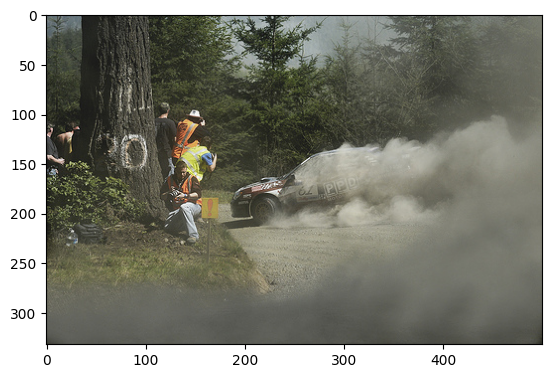

Two boys and a white dog stand in a park .

!!This image is unavailable in your country in compliance with local laws.!!

People strolling through an indoor market .
target score predict: 0.26358567863896454


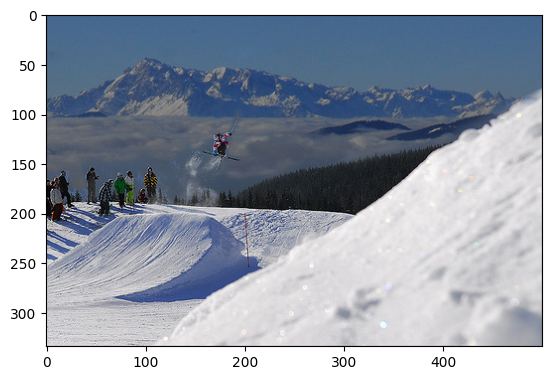

Grey horse wearing blue cover eating from a orange bucket held by a person in a green shirt .
target score predict: 0.2926084928292316


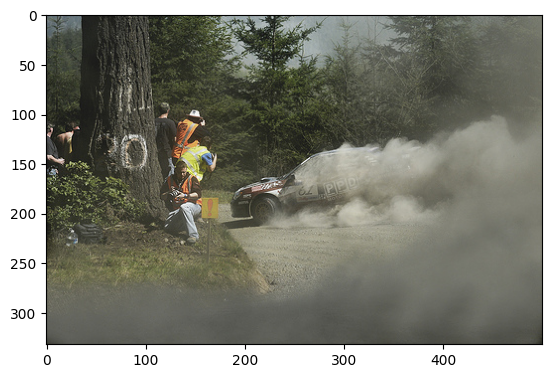

Three men form an arch during a BMX bike race sponsored by Coca-Cola .
target score predict: 0.23779452871512774


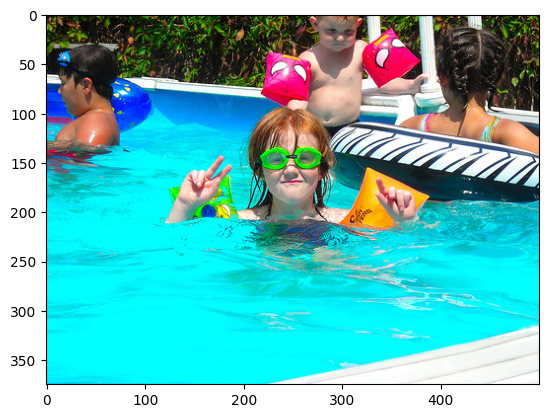

Two men are standing under a large work of art by a brick building .
target score predict: 0.18567563997754144


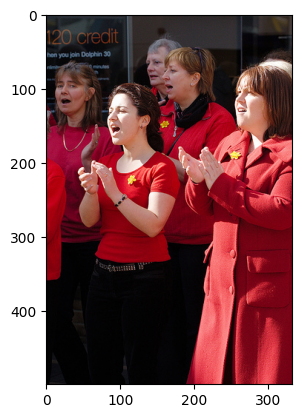

Two boys playing in water .

!!This image is unavailable in your country in compliance with local laws.!!

Girls with orange hair standing on the street with some kind of bottle in their hand .

!!This image is unavailable in your country in compliance with local laws.!!

The woman lacrosse player in blue is about to catch the ball .
target score predict: 0.21304368957290443


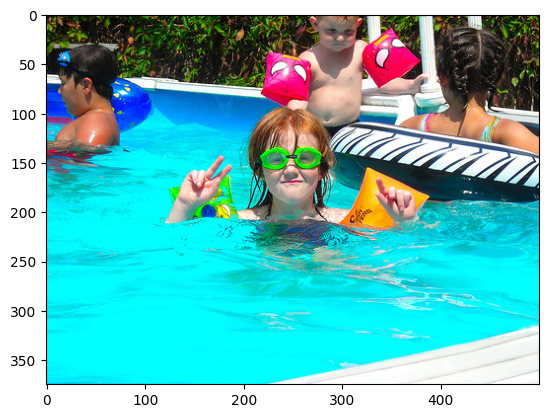

A black and white dog biting onto a chunk of ice .
target score predict: 0.32579794540200924


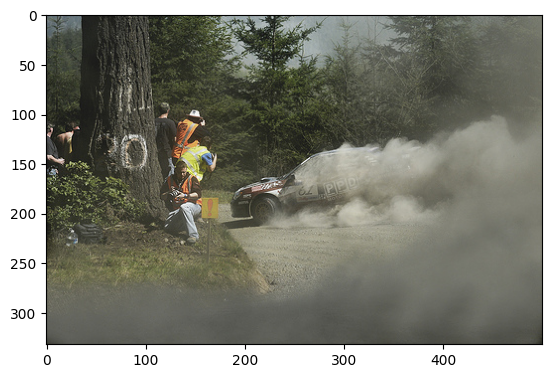

Two women , one with a head bandanna , are standing next to each other while one holds a bottle .
target score predict: 0.1496552826454458


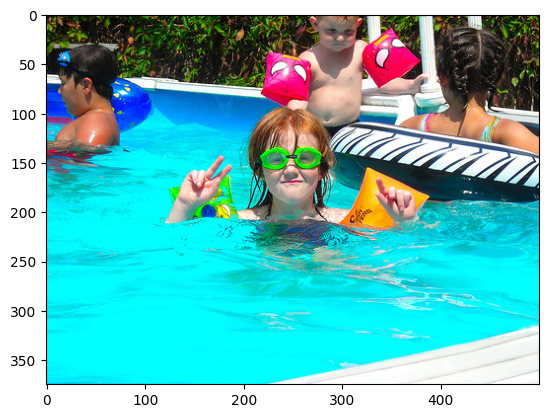

A man riding a wakeboard on a lake
target score predict: 0.30824908684385166


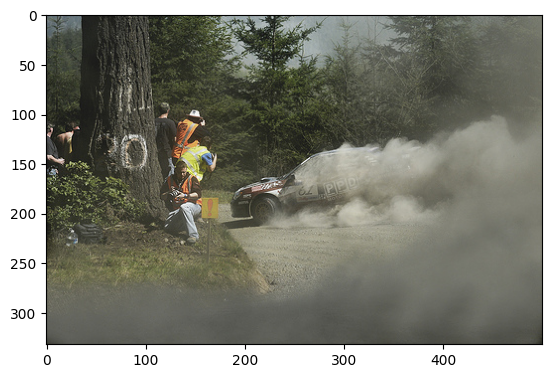

A man with a white hat and plaid shirt behind a woman with a red headdress .
target score predict: 0.1744924132748733


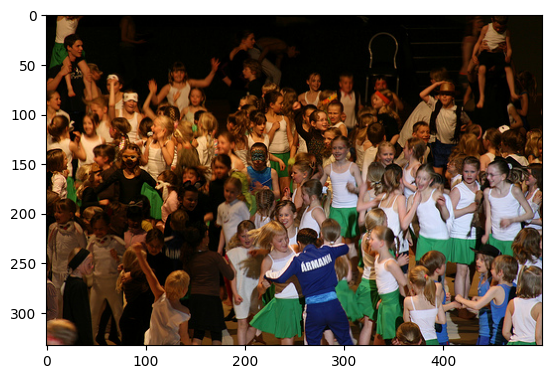

In [ ]:
test_model.make_n_query(10)

Модель очевидно не работает. Попробуем решить задачу ранжирования

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
Метрику близости вывел, предупреждение было и раньше, я выделил его более явно.
</div>

## <a id='toc2_11_'></a>[Ранжирование с catboost](#toc0_)

In [ ]:
# для задачи ранжирования нужно передать в катбуст информацию об одинаковых запросах
index_to_text_train = {
    image_name: num for num, image_name in enumerate(set(train_df["query_text"]))
}
query_id_train = [
    index_to_text_train[query] for query in train_df["query_text"].to_list()
]

index_to_text_test = {
    image_name: num for num, image_name in enumerate(set(test_df["query_text"]))
}
query_id_test = [index_to_text_test[query] for query in test_df["query_text"].to_list()]

len(query_id_test), len(query_id_train)

(808, 3277)

In [ ]:
X_train = train_df.drop(
    columns=["index", "image", "query_id", "query_text", "ratio_expert"]
)
y_train = train_df["ratio_expert"]

X_test = test_df.drop(
    columns=["index", "image", "query_id", "query_text", "ratio_expert"]
)
y_test = test_df["ratio_expert"]

In [ ]:
train = Pool(data=X_train, label=y_train, group_id=query_id_train)

test = Pool(data=X_test, label=y_test, group_id=query_id_test)

При ранжировании из выберем метрку NDCG, так как она нормализована, считается при таргете в промежутке от [0, 1]. Возьмем топ 2, 3, 4.

In [ ]:
default_parameters = {
    "iterations": 3000,
    "custom_metric": ["NDCG:top=2", "NDCG:top=3", "NDCG:top=4"],
    "verbose": False,
    "random_seed": 0,
    "task_type": "GPU",
    "devices": "0",
    "boosting_type": "Ordered",
    "leaf_estimation_method": "Newton",
    "loss_function": "QueryRMSE",
    "learning_rate": 0.003,
}

modelrank = CatBoostRanker(**default_parameters)
modelrank.fit(train, eval_set=test, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Default metric period is 5 because NDCG is/are not implemented for GPU
Metric NDCG:top=2;type=Base is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time
Metric NDCG:top=3;type=Base is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time
Metric NDCG:top=4;type=Base is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time


In [ ]:
test_model_rank = TestModel(
    modelrank,
    path_test_img=path_test_img,
    path_test_img_df=path_test_img_df,
    path_test_query=path_test_query,
)

A boy in blue is riding his bike in a skate park .

!!This image is unavailable in your country in compliance with local laws.!!

Two people , one in blue and one in red , stand in front of a building .
target score predict: 0.02530192700361071


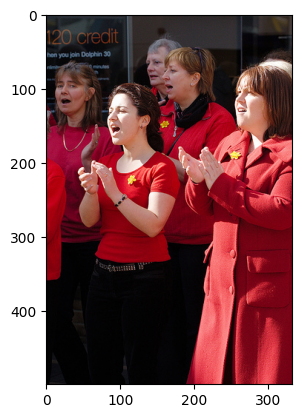

A little girls waist high in sand

!!This image is unavailable in your country in compliance with local laws.!!

A dog is wearing jeans and a blue and yellow shirt with a black vehicle in the background .
target score predict: 0.05432959419914915


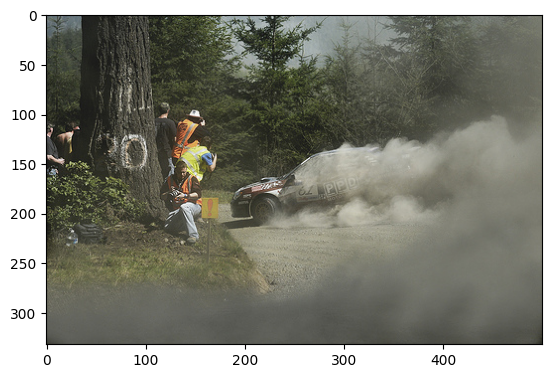

A young boy wearing a red shirt stands in the street with his arms open wide .

!!This image is unavailable in your country in compliance with local laws.!!

A dog jumps to catch a red ball outside .
target score predict: 0.07781758870706044


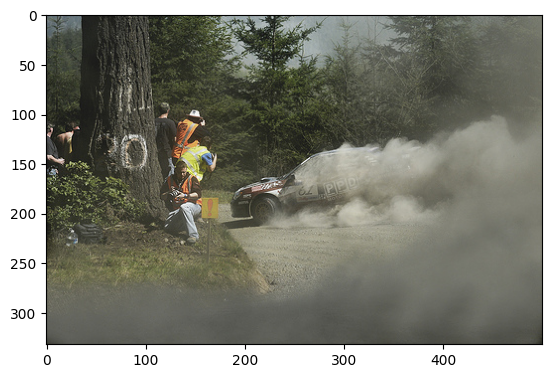

A red haired girl making a peace sign is wearing neon green glasses and floaties and playing in the pool with other kids .

!!This image is unavailable in your country in compliance with local laws.!!

A large bird spreading his wings in flight over a body of water .
target score predict: 0.0540118540971021


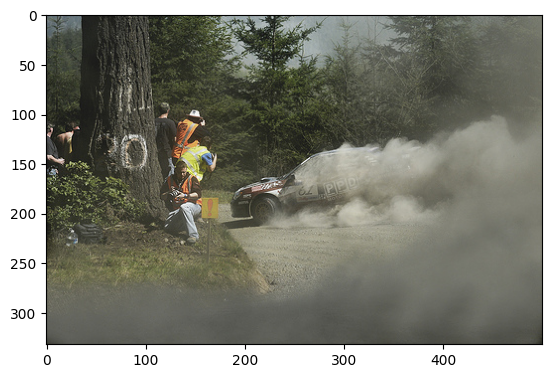

a boy in a blue top is jumping off some rocks in the woods .

!!This image is unavailable in your country in compliance with local laws.!!

a group of teenagers standing outside of a convienance store .

!!This image is unavailable in your country in compliance with local laws.!!

A man playing tennis looks very happy .
target score predict: 0.032377591147162446


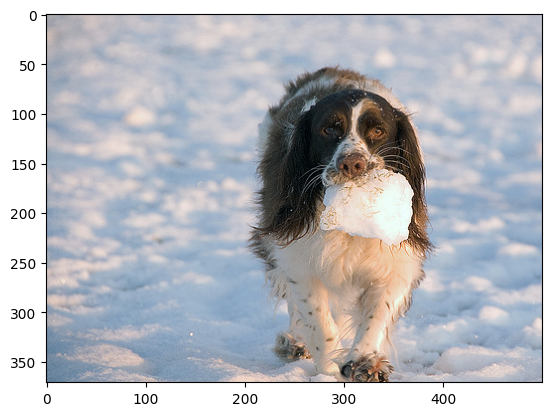

Two men are standing under a large work of art by a brick building .
target score predict: 0.022518573859841483


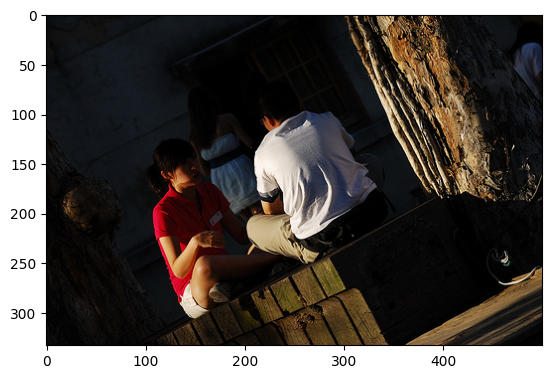

A group of women wearing red all rally together .
target score predict: 0.02157832984257985


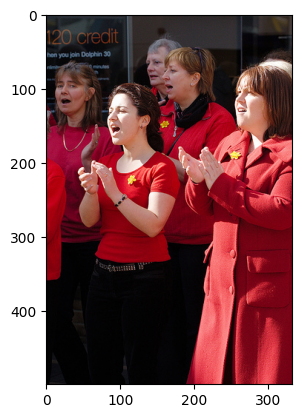

Two Muslim woman wearing their head scarves and frowning faces .
target score predict: 0.020158286131254206


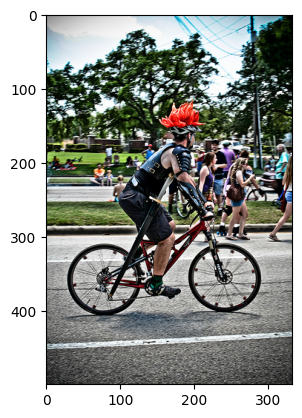

Three teenagers drink Slurpees outside a convienience store .

!!This image is unavailable in your country in compliance with local laws.!!

A little girl dressed in a pink shirt , blue shorts and a pink hair ribbon feeding ducks that are swimming in water .

!!This image is unavailable in your country in compliance with local laws.!!

Woman with glasses working at a sewing machine .
target score predict: 0.02884258961553731


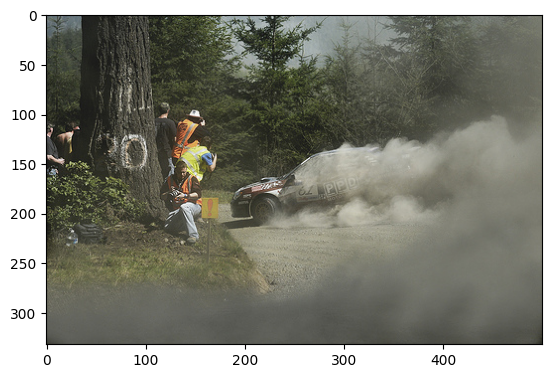

The dog jumps up to catch the red ball .
target score predict: 0.05316018295848905


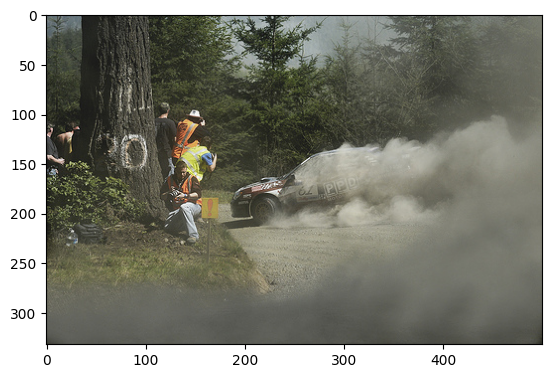

In [ ]:
test_model_rank.make_n_query(10)

Несмотря на то что при обучении метрики модели приближались к 1, модель на практке работает также плохо. Подскажите, пожалуйста, где я ошибаюсь.

## <a id='toc2_12_'></a>[Вывод](#toc0_)

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
Решить задачу путем самостоятельного обучения моделей не получилось. Возможно в дальнейшем воспользоватся трансформерами или взять готовую модуль с лицензией на коммерческое использование. 
</div>